# EMPLOYEE PROMOTION PREDICTION
By: **OFINNI OLUWASEUN ABEL**

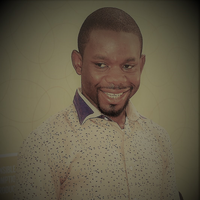

In [1]:
from PIL import Image
image = Image.open("Abel.jpg")
height = 200
width = 200
Author = image.resize((width, height),Image.ANTIALIAS)
Author

In [2]:
# import the required package and libraries
import pandas as pd
import numpy as np
from numpy import sort
import matplotlib.pyplot as plt
import pandas_profiling as pp
from datetime import datetime

# Standard plotly imports
from matplotlib import pyplot as plt
import seaborn as sns
%matplotlib inline
import plotly.plotly as py
import plotly.graph_objs as go
from plotly.offline import iplot, init_notebook_mode

# Using plotly + cufflinks in offline mode
import cufflinks
cufflinks.go_offline(connected=True)
init_notebook_mode(connected=False)

# Classifier Algorithms for experiment before final selection
from sklearn import linear_model
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.linear_model import SGDClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC, LinearSVC
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from xgboost import XGBClassifier

#Other relevant modules for our experiment
import xgboost as xgb
from sklearn.model_selection import RandomizedSearchCV,GridSearchCV
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from xgboost import plot_tree
from xgboost import plot_importance
from sklearn.metrics import accuracy_score
from sklearn.feature_selection import SelectFromModel
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split

#We obviously don't want to keep getting that Red Box showing up in the experiment
import warnings
warnings.filterwarnings(action="ignore") #We have ignored it now. So, we are good to go.

# Getting our Data for the Experiment is as equally important.
* We have two Data set for this experiment
     * Train Dataset: This contain the attributes that would be used and the target variable of our experiment
     * Test Dataset: Here we have the attributes which are similar to what we have in the Train set with exception of Target    variable

In [3]:
#Load the train data
train=pd.read_csv('train.csv')
#Load the test data
test=pd.read_csv('test.csv')

In [4]:
#Data information
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 38312 entries, 0 to 38311
Data columns (total 19 columns):
EmployeeNo                             38312 non-null object
Division                               38312 non-null object
Qualification                          36633 non-null object
Gender                                 38312 non-null object
Channel_of_Recruitment                 38312 non-null object
Trainings_Attended                     38312 non-null int64
Year_of_birth                          38312 non-null int64
Last_performance_score                 38312 non-null float64
Year_of_recruitment                    38312 non-null int64
Targets_met                            38312 non-null int64
Previous_Award                         38312 non-null int64
Training_score_average                 38312 non-null int64
State_Of_Origin                        38312 non-null object
Foreign_schooled                       38312 non-null object
Marital_Status                         383

In [5]:
#Data information
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16496 entries, 0 to 16495
Data columns (total 18 columns):
EmployeeNo                             16496 non-null object
Division                               16496 non-null object
Qualification                          15766 non-null object
Gender                                 16496 non-null object
Channel_of_Recruitment                 16496 non-null object
Trainings_Attended                     16496 non-null int64
Year_of_birth                          16496 non-null int64
Last_performance_score                 16496 non-null float64
Year_of_recruitment                    16496 non-null int64
Targets_met                            16496 non-null int64
Previous_Award                         16496 non-null int64
Training_score_average                 16496 non-null int64
State_Of_Origin                        16496 non-null object
Foreign_schooled                       16496 non-null object
Marital_Status                         164

In [6]:
train.head()

,EmployeeNo,Division,Qualification,Gender,Channel_of_Recruitment,Trainings_Attended,Year_of_birth,Last_performance_score,Year_of_recruitment,Targets_met,Previous_Award,Training_score_average,State_Of_Origin,Foreign_schooled,Marital_Status,Past_Disciplinary_Action,Previous_IntraDepartmental_Movement,No_of_previous_employers,Promoted_or_Not
0,YAK/S/00001,Commercial Sales and Marketing,"MSc, MBA and PhD",Female,Direct Internal process,2,1986,12.5,2011,1,0,41,ANAMBRA,No,Married,No,No,0,0
1,YAK/S/00002,Customer Support and Field Operations,First Degree or HND,Male,Agency and others,2,1991,12.5,2015,0,0,52,ANAMBRA,Yes,Married,No,No,0,0
2,YAK/S/00003,Commercial Sales and Marketing,First Degree or HND,Male,Direct Internal process,2,1987,7.5,2012,0,0,42,KATSINA,Yes,Married,No,No,0,0
3,YAK/S/00004,Commercial Sales and Marketing,First Degree or HND,Male,Agency and others,3,1982,2.5,2009,0,0,42,NIGER,Yes,Single,No,No,1,0
4,YAK/S/00006,Information and Strategy,First Degree or HND,Male,Direct Internal process,3,1990,7.5,2012,0,0,77,AKWA IBOM,Yes,Married,No,No,1,0


In [7]:
train.tail(5)

,EmployeeNo,Division,Qualification,Gender,Channel_of_Recruitment,Trainings_Attended,Year_of_birth,Last_performance_score,Year_of_recruitment,Targets_met,Previous_Award,Training_score_average,State_Of_Origin,Foreign_schooled,Marital_Status,Past_Disciplinary_Action,Previous_IntraDepartmental_Movement,No_of_previous_employers,Promoted_or_Not
38307,YAK/S/54802,Information Technology and Solution Support,First Degree or HND,Female,Direct Internal process,2,1990,0.0,2018,0,0,70,LAGOS,Yes,Married,No,No,0,0
38308,YAK/S/54805,Customer Support and Field Operations,"MSc, MBA and PhD",Female,Agency and others,2,1984,5.0,2013,0,0,48,IMO,Yes,Married,No,No,1,0
38309,YAK/S/54806,Information and Strategy,First Degree or HND,Male,Agency and others,2,1994,12.5,2016,1,0,71,ANAMBRA,No,Married,No,No,3,0
38310,YAK/S/54807,Commercial Sales and Marketing,NaN,Male,Direct Internal process,2,1992,2.5,2017,0,0,37,KWARA,Yes,Married,No,No,1,0
38311,YAK/S/54808,People/HR Management,First Degree or HND,Male,Agency and others,2,1994,2.5,2014,0,0,41,KWARA,Yes,Single,No,No,2,0


In [8]:
test.head()

,EmployeeNo,Division,Qualification,Gender,Channel_of_Recruitment,Trainings_Attended,Year_of_birth,Last_performance_score,Year_of_recruitment,Targets_met,Previous_Award,Training_score_average,State_Of_Origin,Foreign_schooled,Marital_Status,Past_Disciplinary_Action,Previous_IntraDepartmental_Movement,No_of_previous_employers
0,YAK/S/00005,Information Technology and Solution Support,First Degree or HND,Male,Agency and others,2,1976,7.5,2017,0,0,65,FCT,Yes,Married,No,No,1
1,YAK/S/00011,Information Technology and Solution Support,NaN,Male,Direct Internal process,2,1991,0.0,2018,0,0,69,OGUN,Yes,Married,No,No,1
2,YAK/S/00015,Research and Innovation,"MSc, MBA and PhD",Male,Direct Internal process,2,1984,7.5,2012,0,0,76,KANO,Yes,Married,No,No,1
3,YAK/S/00016,Customer Support and Field Operations,First Degree or HND,Male,Agency and others,2,1984,2.5,2009,0,0,52,RIVERS,No,Single,No,No,1
4,YAK/S/00017,Information Technology and Solution Support,First Degree or HND,Male,Agency and others,2,1983,7.5,2014,1,0,69,FCT,Yes,Married,No,No,0


In [9]:
test.tail()

,EmployeeNo,Division,Qualification,Gender,Channel_of_Recruitment,Trainings_Attended,Year_of_birth,Last_performance_score,Year_of_recruitment,Targets_met,Previous_Award,Training_score_average,State_Of_Origin,Foreign_schooled,Marital_Status,Past_Disciplinary_Action,Previous_IntraDepartmental_Movement,No_of_previous_employers
16491,YAK/S/54797,Commercial Sales and Marketing,"MSc, MBA and PhD",Male,Agency and others,2,1987,7.5,2012,0,0,52,PLATEAU,Yes,Married,No,No,1
16492,YAK/S/54798,Commercial Sales and Marketing,First Degree or HND,Male,Direct Internal process,2,1993,12.5,2016,1,1,39,OGUN,Yes,Single,No,No,0
16493,YAK/S/54800,Sourcing and Purchasing,"MSc, MBA and PhD",Female,Agency and others,2,1971,12.5,2013,1,1,59,NASSARAWA,Yes,Married,No,No,0
16494,YAK/S/54803,Commercial Sales and Marketing,First Degree or HND,Male,Agency and others,3,1990,2.5,2017,0,0,41,OGUN,Yes,Married,No,No,3
16495,YAK/S/54804,Information Technology and Solution Support,First Degree or HND,Male,Direct Internal process,2,1973,7.5,2002,0,0,70,ANAMBRA,Yes,Married,No,No,1


In [10]:
#Check the dimension of the train data
train.shape

(38312, 19)

In [11]:
#Check the dimension of the test data
test.shape

(16496, 18)

In [12]:
train.columns

Index(['EmployeeNo', 'Division', 'Qualification', 'Gender',
       'Channel_of_Recruitment', 'Trainings_Attended', 'Year_of_birth',
       'Last_performance_score', 'Year_of_recruitment', 'Targets_met',
       'Previous_Award', 'Training_score_average', 'State_Of_Origin',
       'Foreign_schooled', 'Marital_Status', 'Past_Disciplinary_Action',
       'Previous_IntraDepartmental_Movement', 'No_of_previous_employers',
       'Promoted_or_Not'],
      dtype='object')

In [13]:
test.columns

Index(['EmployeeNo', 'Division', 'Qualification', 'Gender',
       'Channel_of_Recruitment', 'Trainings_Attended', 'Year_of_birth',
       'Last_performance_score', 'Year_of_recruitment', 'Targets_met',
       'Previous_Award', 'Training_score_average', 'State_Of_Origin',
       'Foreign_schooled', 'Marital_Status', 'Past_Disciplinary_Action',
       'Previous_IntraDepartmental_Movement', 'No_of_previous_employers'],
      dtype='object')

In [14]:
#Check the descriptive statistics of quantitative variables in our dataset
train.describe()

,Trainings_Attended,Year_of_birth,Last_performance_score,Year_of_recruitment,Targets_met,Previous_Award,Training_score_average,Promoted_or_Not
count,38312.000000,38312.000000,38312.000000,38312.000000,38312.000000,38312.000000,38312.000000,38312.000000
mean,2.253680,1986.209334,7.698959,2013.139695,0.352996,0.023152,55.366465,0.084595
std,0.609443,7.646047,3.744135,4.261451,0.477908,0.150388,13.362741,0.278282
min,2.000000,1950.000000,0.000000,1982.000000,0.000000,0.000000,31.000000,0.000000
25%,2.000000,1982.000000,5.000000,2012.000000,0.000000,0.000000,43.000000,0.000000
50%,2.000000,1988.000000,7.500000,2014.000000,0.000000,0.000000,52.000000,0.000000
75%,2.000000,1992.000000,10.000000,2016.000000,1.000000,0.000000,68.000000,0.000000
max,11.000000,2001.000000,12.500000,2018.000000,1.000000,1.000000,91.000000,1.000000


In [15]:
#Check the descriptive statistics of quantitative variables in our dataset
test.describe()

,Trainings_Attended,Year_of_birth,Last_performance_score,Year_of_recruitment,Targets_met,Previous_Award,Training_score_average
count,16496.000000,16496.000000,16496.000000,16496.000000,16496.000000,16496.000000,16496.000000
mean,2.251455,1986.161130,7.692016,2013.122393,0.349600,0.023218,55.433863
std,0.608865,7.708188,3.734303,4.273649,0.476858,0.150599,13.392306
min,2.000000,1958.000000,0.000000,1986.000000,0.000000,0.000000,31.000000
25%,2.000000,1982.000000,5.000000,2011.000000,0.000000,0.000000,43.000000
50%,2.000000,1988.000000,7.500000,2014.000000,0.000000,0.000000,52.000000
75%,2.000000,1992.000000,10.000000,2016.000000,1.000000,0.000000,68.000000
max,11.000000,2001.000000,12.500000,2018.000000,1.000000,1.000000,91.000000


So, from the glimpse into out dataset, we have seen what our target variable looks like

In [16]:
#Check for Null Values and then confirm their spreads in our dataset
train.isnull().sum()

EmployeeNo                                0
Division                                  0
Qualification                          1679
Gender                                    0
Channel_of_Recruitment                    0
Trainings_Attended                        0
Year_of_birth                             0
Last_performance_score                    0
Year_of_recruitment                       0
Targets_met                               0
Previous_Award                            0
Training_score_average                    0
State_Of_Origin                           0
Foreign_schooled                          0
Marital_Status                            0
Past_Disciplinary_Action                  0
Previous_IntraDepartmental_Movement       0
No_of_previous_employers                  0
Promoted_or_Not                           0
dtype: int64

In [17]:
#Check for Null Values and then confirm their spreads in our dataset
test.isnull().sum()

EmployeeNo                               0
Division                                 0
Qualification                          730
Gender                                   0
Channel_of_Recruitment                   0
Trainings_Attended                       0
Year_of_birth                            0
Last_performance_score                   0
Year_of_recruitment                      0
Targets_met                              0
Previous_Award                           0
Training_score_average                   0
State_Of_Origin                          0
Foreign_schooled                         0
Marital_Status                           0
Past_Disciplinary_Action                 0
Previous_IntraDepartmental_Movement      0
No_of_previous_employers                 0
dtype: int64

In [18]:
#Let's verify the location of the missing data in our dataset, then we can visualise it.  
train[train.isnull().any(axis=1)]

,EmployeeNo,Division,Qualification,Gender,Channel_of_Recruitment,Trainings_Attended,Year_of_birth,Last_performance_score,Year_of_recruitment,Targets_met,Previous_Award,Training_score_average,State_Of_Origin,Foreign_schooled,Marital_Status,Past_Disciplinary_Action,Previous_IntraDepartmental_Movement,No_of_previous_employers,Promoted_or_Not
15,YAK/S/00022,Customer Support and Field Operations,NaN,Male,Direct Internal process,2,1980,10.0,2008,0,0,49,RIVERS,Yes,Married,No,No,1,0
22,YAK/S/00033,Commercial Sales and Marketing,NaN,Female,Direct Internal process,2,1997,2.5,2017,0,0,40,EDO,Yes,Married,No,No,1,0
28,YAK/S/00044,Commercial Sales and Marketing,NaN,Male,Agency and others,4,1997,5.0,2017,0,0,40,CROSS RIVER,Yes,Married,No,No,1,0
60,YAK/S/00091,Commercial Sales and Marketing,NaN,Female,Direct Internal process,2,2001,0.0,2018,0,0,47,ZAMFARA,Yes,Single,No,No,2,0
137,YAK/S/00190,Customer Support and Field Operations,NaN,Female,Agency and others,2,1988,10.0,2010,0,0,56,LAGOS,Yes,Single,No,No,5,0
168,YAK/S/00232,Commercial Sales and Marketing,NaN,Male,Agency and others,2,1999,10.0,2017,0,0,43,LAGOS,Yes,Single,No,No,0,0
198,YAK/S/00278,Information and Strategy,NaN,Male,Direct Internal process,2,1990,7.5,2015,0,0,77,LAGOS,Yes,Married,No,No,1,0
240,YAK/S/00337,Customer Support and Field Operations,NaN,Male,Agency and others,2,1973,7.5,2011,0,0,49,ADAMAWA,No,Married,No,No,0,0
253,YAK/S/00353,Customer Support and Field Operations,NaN,Female,Agency and others,2,1963,10.0,2001,1,0,52,OGUN,Yes,Married,No,No,0,0
255,YAK/S/00355,Commercial Sales and Marketing,NaN,Male,Agency and others,2,1997,10.0,2017,0,0,43,FCT,Yes,Married,No,No,0,0


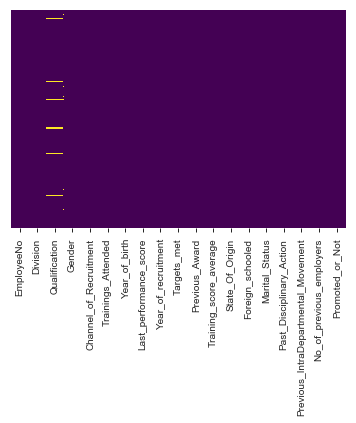

In [19]:
#Let's visualise the spread of the missing data in our train dataset to give us a clue of how best to deal with it.
sns.heatmap(train.isnull(),yticklabels= False,cbar= False, cmap='viridis')

In [20]:
#Let's verify the location of the missing data in our test set, then we can visualise it.
test[test.isnull().any(axis=1)]

,EmployeeNo,Division,Qualification,Gender,Channel_of_Recruitment,Trainings_Attended,Year_of_birth,Last_performance_score,Year_of_recruitment,Targets_met,Previous_Award,Training_score_average,State_Of_Origin,Foreign_schooled,Marital_Status,Past_Disciplinary_Action,Previous_IntraDepartmental_Movement,No_of_previous_employers
1,YAK/S/00011,Information Technology and Solution Support,NaN,Male,Direct Internal process,2,1991,0.0,2018,0,0,69,OGUN,Yes,Married,No,No,1
27,YAK/S/00083,Commercial Sales and Marketing,NaN,Male,Direct Internal process,3,1996,7.5,2017,0,0,45,FCT,Yes,Married,No,No,1
29,YAK/S/00088,Commercial Sales and Marketing,NaN,Male,Direct Internal process,2,1982,2.5,2010,0,0,41,ONDO,Yes,Married,No,No,1
56,YAK/S/00205,Customer Support and Field Operations,NaN,Female,Agency and others,2,1990,10.0,2017,0,0,54,OGUN,Yes,Married,No,No,0
66,YAK/S/00246,Research and Innovation,NaN,Male,Agency and others,2,1996,0.0,2018,1,0,68,LAGOS,Yes,Single,No,No,1
90,YAK/S/00324,Commercial Sales and Marketing,NaN,Male,Agency and others,2,1999,12.5,2017,0,0,54,ENUGU,Yes,Married,No,No,2
117,YAK/S/00416,Information and Strategy,NaN,Male,Agency and others,2,1994,7.5,2017,0,0,80,KWARA,Yes,Single,Yes,No,1
118,YAK/S/00417,Commercial Sales and Marketing,NaN,Male,Agency and others,2,1978,2.5,2015,0,0,41,LAGOS,Yes,Married,No,No,1
149,YAK/S/00509,Commercial Sales and Marketing,NaN,Female,Agency and others,3,1981,0.0,2018,1,0,43,LAGOS,Yes,Married,No,Yes,0
164,YAK/S/00575,Commercial Sales and Marketing,NaN,Male,Agency and others,2,1997,7.5,2017,1,1,73,KADUNA,Yes,Married,No,No,0


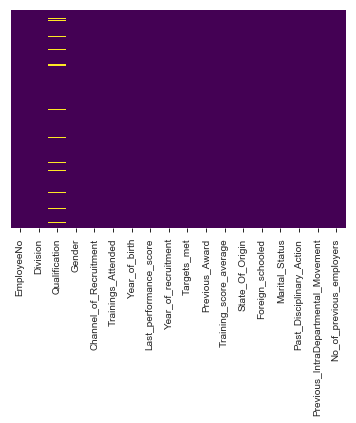

In [21]:
#Let's visualise the spread of the missing data in our train dataset to give us a clue of how best to deal with it.
sns.heatmap(test.isnull(),yticklabels= False,cbar= False, cmap='viridis')

In [22]:
#Let's take a deeper look into our dataset by checking the profile of each attribute and a quick overview with relevant tips to guide us.
Data_Profile = pp.ProfileReport(train)
Data_Profile

In [23]:
Data_Profile_2 = pp.ProfileReport(test)
Data_Profile_2

# UNIVARIATE VISUALISATIONS

In [24]:
#Let's Visualise the target's (Promoted_or_Not) distribution
train['Promoted_or_Not'].iplot(kind='hist', xTitle='Promotion (0=Yes, 1=No)',
yTitle ='count', title='Distribution of Promotion')

Based on the Profile of 'State_of_Origin', there are 37 levels in the categorical variable. It's best practice, if we verify it's distribution by visualising it with an interactive plot.

In [25]:
#Check State's distribution
train['State_Of_Origin'].iplot(kind='hist', xTitle='State of Origin',
yTitle ='count', title='Employees States of Origin')

In [26]:
#Check State's distribution
test['State_Of_Origin'].iplot(kind='hist', xTitle='State of Origin',
yTitle ='count', title='Employees States of Origin')

In [27]:
#Check Gender distribution
train['Gender'].iplot(kind='hist', xTitle="Employees' Gender",
yTitle ='count', title="Employees' Gender Distribution")

In [28]:
#Check Gender distribution
test['Gender'].iplot(kind='hist', xTitle="Employees' Gender",
yTitle ='count', title="Employees' Gender Distribution")

In [29]:
#Check Performance distribution
train['Last_performance_score'].iplot(kind='hist', xTitle='Performance Score',
yTitle ='count', title='Employees Last Performance Score')

In [30]:
#Check Performance distribution
test['Last_performance_score'].iplot(kind='hist', xTitle='Performance Score',
yTitle ='count', title='Employees Last Performance Score')

In [31]:
#Check Averaged Training Scores' distribution
train['Training_score_average'].iplot(kind='hist', xTitle= 'Average of Training Score',
yTitle ='count', title='Employees Averaged Training Scores')

In [32]:
#Check Averaged Training Scores' distribution
test['Training_score_average'].iplot(kind='hist', xTitle= 'Average of Training Score',
yTitle ='count', title='Employees Averaged Training Scores')

In [33]:
#Check Averaged Training Scores' distribution
train['Trainings_Attended'].iplot(kind='hist', xTitle= 'Number of Training',
yTitle ='count', title='Number of Past Trainings')

In [34]:
#Check Averaged Training Scores' distribution
test['Trainings_Attended'].iplot(kind='hist', xTitle= 'Number of Training',
yTitle ='count', title='Number of Past Trainings')

In [35]:
#Check Qualification distribution. Note: NaN would not feature in the measurement
train['Qualification'].iplot(kind='hist', xTitle= 'Educational Qualification',
yTitle ='count', title='Level of Education')

In [36]:
#Ch#Check Qualification distribution. Note: NaN would not feature in the measurement
test['Qualification'].iplot(kind='hist', xTitle= 'Educational Qualification',
yTitle ='count', title='Level of Education')

# DATA CLEANING
* We have NaN as the missing values in Qulaification. The three levels I'm familiar with have been exhausted here, so, I'll replace the NaN with 'Unknown' for the purpose of analysis and interpretations.

* I'll be dealing with all the categorical variables in the two Data Sets in this section.

* Numerical variable that are not Normally distributed would be addressed here and we can intuitively generate other varibales from their results if necessary. 

In [37]:
#Treating missing Data
train_df = train.fillna('Unknown')
test_df = test.fillna('Unknown')

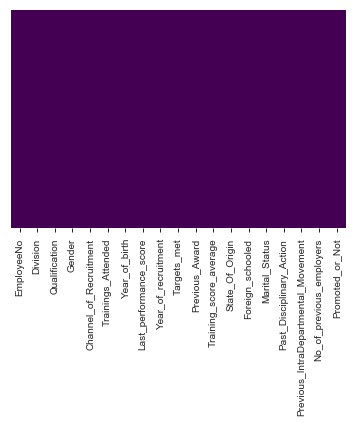

In [38]:
sns.heatmap(train_df.isnull(),yticklabels= False,cbar= False, cmap='viridis')

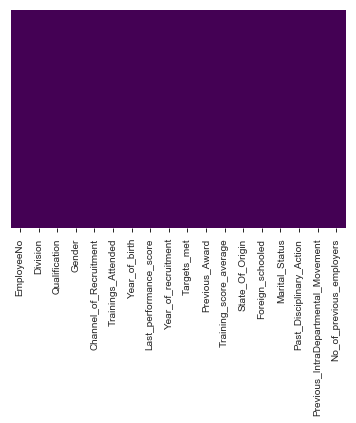

In [39]:
sns.heatmap(test_df.isnull(),yticklabels= False,cbar= False, cmap='viridis')

**TREATING ALL THE CATEGORICAL ATTRIBUTES AVAILABLE IN OUR DATASETS**

In [40]:
train_df['State_Of_Origin'].head(10)

0      ANAMBRA
1      ANAMBRA
2      KATSINA
3        NIGER
4    AKWA IBOM
5        ENUGU
6          OYO
7        LAGOS
8         ONDO
9        LAGOS
Name: State_Of_Origin, dtype: object

In [41]:
test_df['State_Of_Origin'].head(10)

0       FCT
1      OGUN
2      KANO
3    RIVERS
4       FCT
5     BENUE
6       FCT
7       FCT
8     LAGOS
9    RIVERS
Name: State_Of_Origin, dtype: object

In [42]:
#Here We will create the States Values as their geo-political zone, then we'll replace the zone with numbers ranging from 1-6. Nigeria States are distributed into 6 geo-political zones 
# 1.North Central 2.North East 3. North West 4. South East 5. South West 6.South South. 
Region1 = {"BENUE":"North-Central", "KOGI":"North-Central", "KWARA":"North-Central", "NASSARAWA":"North-Central",
            "NIGER":"North-Central", "PLATEAU":"North-Central", "FCT":"North-Central", "ADAMAWA":"North-East", "BAUCHI":"North-East", 
            "BORNO":"North-East", "GOMBE":"North-East", "TARABA":"North-East", "YOBE":"North-East", "JIGAWA":"North-West","KADUNA":"North-West", 
            "KANO":"North-West", "KATSINA":"North-West", "KEBBI":"North-West", "SOKOTO":"North-West", "ZAMFARA":"North-West", "ABIA":"South-East", 
            "ANAMBRA":"South-East", "EBONYI":"South-East", "ENUGU":"South-East", "IMO":"South-East", "AKWA IBOM":"South-South", "BAYELSA":"South-South",
            "CROSS RIVER":"South-South", "RIVERS":"South-South", "DELTA":"South-South", "EDO":"South-South", "EKITI":"South-West", "LAGOS":"South-West",
            "OGUN":"South-West", "ONDO":"South-West", "OSUN":"South-West", "OYO":"South-West"}

Region_value = {"North-Central": 1, "North-East": 2, "North-West": 3, "South-East": 4, "South-West": 5, "South-South": 6}

data = [train_df, test_df]
for dataset in data:
    dataset['State_Of_Origin'] = dataset['State_Of_Origin'].map(Region1)

data = [train_df, test_df]
for dataset in data:
    dataset['State_Of_Origin'] = dataset['State_Of_Origin'].map(Region_value)

test_df.head()

,EmployeeNo,Division,Qualification,Gender,Channel_of_Recruitment,Trainings_Attended,Year_of_birth,Last_performance_score,Year_of_recruitment,Targets_met,Previous_Award,Training_score_average,State_Of_Origin,Foreign_schooled,Marital_Status,Past_Disciplinary_Action,Previous_IntraDepartmental_Movement,No_of_previous_employers
0,YAK/S/00005,Information Technology and Solution Support,First Degree or HND,Male,Agency and others,2,1976,7.5,2017,0,0,65,1,Yes,Married,No,No,1
1,YAK/S/00011,Information Technology and Solution Support,Unknown,Male,Direct Internal process,2,1991,0.0,2018,0,0,69,5,Yes,Married,No,No,1
2,YAK/S/00015,Research and Innovation,"MSc, MBA and PhD",Male,Direct Internal process,2,1984,7.5,2012,0,0,76,3,Yes,Married,No,No,1
3,YAK/S/00016,Customer Support and Field Operations,First Degree or HND,Male,Agency and others,2,1984,2.5,2009,0,0,52,6,No,Single,No,No,1
4,YAK/S/00017,Information Technology and Solution Support,First Degree or HND,Male,Agency and others,2,1983,7.5,2014,1,0,69,1,Yes,Married,No,No,0


In [43]:
train_df['State_Of_Origin'].iplot(kind='hist', xTitle="Region of Origin" ,
yTitle ='count', title="Distribution of Employees' Region of Origin")

In [44]:
test_df['State_Of_Origin'].iplot(kind='hist', xTitle="Region of Origin" ,
yTitle ='count', title="Distribution of Employees' Region of Origin")

In [45]:
train_df['State_Of_Origin'] = train_df['State_Of_Origin'].astype('float')
test_df['State_Of_Origin'] = test_df['State_Of_Origin'].astype('float')

In [46]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16496 entries, 0 to 16495
Data columns (total 18 columns):
EmployeeNo                             16496 non-null object
Division                               16496 non-null object
Qualification                          16496 non-null object
Gender                                 16496 non-null object
Channel_of_Recruitment                 16496 non-null object
Trainings_Attended                     16496 non-null int64
Year_of_birth                          16496 non-null int64
Last_performance_score                 16496 non-null float64
Year_of_recruitment                    16496 non-null int64
Targets_met                            16496 non-null int64
Previous_Award                         16496 non-null int64
Training_score_average                 16496 non-null int64
State_Of_Origin                        16496 non-null float64
Foreign_schooled                       16496 non-null object
Marital_Status                         16

In [47]:
Deparments = {'Commercial Sales and Marketing': 1, 'Customer Support and Field Operations': 2, 'Sourcing and Purchasing': 3,
            'Information Technology and Solution Support': 4, 'Information and Strategy': 5, 'Business Finance Operations': 6, 
            'People/HR Management': 7, 'Regulatory and Legal services': 8, 'Research and Innovation': 9}

data = [train_df, test_df]
for dataset in data:
    dataset['Division'] = dataset['Division'].map(Deparments)

test_df.tail()

,EmployeeNo,Division,Qualification,Gender,Channel_of_Recruitment,Trainings_Attended,Year_of_birth,Last_performance_score,Year_of_recruitment,Targets_met,Previous_Award,Training_score_average,State_Of_Origin,Foreign_schooled,Marital_Status,Past_Disciplinary_Action,Previous_IntraDepartmental_Movement,No_of_previous_employers
16491,YAK/S/54797,1,"MSc, MBA and PhD",Male,Agency and others,2,1987,7.5,2012,0,0,52,1.0,Yes,Married,No,No,1
16492,YAK/S/54798,1,First Degree or HND,Male,Direct Internal process,2,1993,12.5,2016,1,1,39,5.0,Yes,Single,No,No,0
16493,YAK/S/54800,3,"MSc, MBA and PhD",Female,Agency and others,2,1971,12.5,2013,1,1,59,1.0,Yes,Married,No,No,0
16494,YAK/S/54803,1,First Degree or HND,Male,Agency and others,3,1990,2.5,2017,0,0,41,5.0,Yes,Married,No,No,3
16495,YAK/S/54804,4,First Degree or HND,Male,Direct Internal process,2,1973,7.5,2002,0,0,70,4.0,Yes,Married,No,No,1


In [48]:
test_df["Qualification"].value_counts()

First Degree or HND         11091
MSc, MBA and PhD             4456
Unknown                       730
Non-University Education      219
Name: Qualification, dtype: int64

In [49]:
exp_1 = pd.get_dummies(train_df["Qualification"])
exp_2 = pd.get_dummies(test_df["Qualification"])

exp_1.rename(columns={'Qualification-First Degree or HND':'First Degree or HND',
                        'Qualification-MSc, MBA and PhD':'MSc, MBA and PhD',
                        'Qualification-Non-University Education':'Non-University Education', 
                        'Qualification-Unknown': 'Unknown'}, inplace=True)
exp_2.rename(columns={'Qualification-First Degree or HND':'First Degree or HND', 
                        'Qualification-MSc, MBA and PhD':'MSc, MBA and PhD',
                        'Qualification-Non-University Education':'Non-University Education', 
                        'Qualification-Unknown': 'Unknown'}, inplace=True)

# merge data  and "exp_1" and "exp_2" accordingly
train_df = pd.concat([train_df, exp_1], axis=1)
test_df = pd.concat([test_df, exp_2], axis=1)

# drop original column "Qualification" from the the two sets
train_df.drop("Qualification", axis = 1, inplace=True)
test_df.drop("Qualification", axis = 1, inplace=True)

test_df.tail()

,EmployeeNo,Division,Gender,Channel_of_Recruitment,Trainings_Attended,Year_of_birth,Last_performance_score,Year_of_recruitment,Targets_met,Previous_Award,...,State_Of_Origin,Foreign_schooled,Marital_Status,Past_Disciplinary_Action,Previous_IntraDepartmental_Movement,No_of_previous_employers,First Degree or HND,"MSc, MBA and PhD",Non-University Education,Unknown
16491,YAK/S/54797,1,Male,Agency and others,2,1987,7.5,2012,0,0,...,1.0,Yes,Married,No,No,1,0,1,0,0
16492,YAK/S/54798,1,Male,Direct Internal process,2,1993,12.5,2016,1,1,...,5.0,Yes,Single,No,No,0,1,0,0,0
16493,YAK/S/54800,3,Female,Agency and others,2,1971,12.5,2013,1,1,...,1.0,Yes,Married,No,No,0,0,1,0,0
16494,YAK/S/54803,1,Male,Agency and others,3,1990,2.5,2017,0,0,...,5.0,Yes,Married,No,No,3,1,0,0,0
16495,YAK/S/54804,4,Male,Direct Internal process,2,1973,7.5,2002,0,0,...,4.0,Yes,Married,No,No,1,1,0,0,0


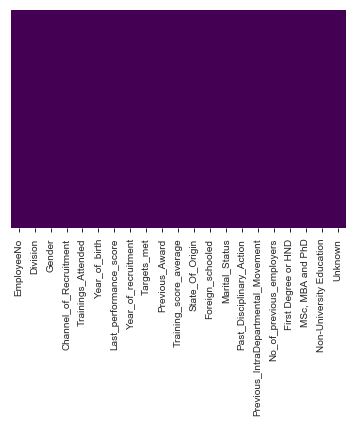

In [50]:
sns.heatmap(test_df.isnull(),yticklabels= False,cbar= False, cmap='viridis')

In [51]:
dummy_1 = pd.get_dummies(train_df["Gender"])
dummy_2 = pd.get_dummies(test_df["Gender"])

dummy_1.rename(columns={'Gender-Female':'Female', 'Gender-Male':'Male'}, inplace=True)
dummy_2.rename(columns={'Gender-Female':'Female', 'Gender-Male':'Male'}, inplace=True)

# merge data  and "dummy_1" and "dummy_2" accordingly
train_df = pd.concat([train_df, dummy_1], axis=1)
test_df = pd.concat([test_df, dummy_2], axis=1)

# drop original column "Gender"
train_df.drop("Gender", axis = 1, inplace=True)
test_df.drop("Gender", axis = 1, inplace=True)

test_df.tail()

,EmployeeNo,Division,Channel_of_Recruitment,Trainings_Attended,Year_of_birth,Last_performance_score,Year_of_recruitment,Targets_met,Previous_Award,Training_score_average,...,Marital_Status,Past_Disciplinary_Action,Previous_IntraDepartmental_Movement,No_of_previous_employers,First Degree or HND,"MSc, MBA and PhD",Non-University Education,Unknown,Female,Male
16491,YAK/S/54797,1,Agency and others,2,1987,7.5,2012,0,0,52,...,Married,No,No,1,0,1,0,0,0,1
16492,YAK/S/54798,1,Direct Internal process,2,1993,12.5,2016,1,1,39,...,Single,No,No,0,1,0,0,0,0,1
16493,YAK/S/54800,3,Agency and others,2,1971,12.5,2013,1,1,59,...,Married,No,No,0,0,1,0,0,1,0
16494,YAK/S/54803,1,Agency and others,3,1990,2.5,2017,0,0,41,...,Married,No,No,3,1,0,0,0,0,1
16495,YAK/S/54804,4,Direct Internal process,2,1973,7.5,2002,0,0,70,...,Married,No,No,1,1,0,0,0,0,1


In [52]:
test_df["Channel_of_Recruitment"].value_counts()

Agency and others                  9136
Direct Internal process            7026
Referral and Special candidates     334
Name: Channel_of_Recruitment, dtype: int64

In [53]:
expe_1 = pd.get_dummies(train_df["Channel_of_Recruitment"])
expe_2 = pd.get_dummies(test_df["Channel_of_Recruitment"])

expe_1.rename(columns={'Channel_of_Recruitment-Agency and others':'Agency and others',
                        'Channel_of_Recruitment-Direct Internal process':'Direct Internal process',
                        'Channel_of_Recruitment-Referral and Special candidates':'Referral and Special candidates'}, inplace=True)
expe_2.rename(columns={'Channel_of_Recruitment-Agency and others':'Agency and others', 
                        'Channel_of_Recruitment-Direct Internal process':'Direct Internal process',
                        'Channel_of_Recruitment-Referral and Special candidates':'Referral and Special candidates'}, inplace=True)

# merge data  and "expe_1" and "expe_2" accordingly
train_df = pd.concat([train_df, expe_1], axis=1)
test_df = pd.concat([test_df, expe_2], axis=1)

# drop original column "Channel_of_Recruitment" from the the two sets
train_df.drop("Channel_of_Recruitment", axis = 1, inplace=True)
test_df.drop("Channel_of_Recruitment", axis = 1, inplace=True)

train_df.head()

,EmployeeNo,Division,Trainings_Attended,Year_of_birth,Last_performance_score,Year_of_recruitment,Targets_met,Previous_Award,Training_score_average,State_Of_Origin,...,Promoted_or_Not,First Degree or HND,"MSc, MBA and PhD",Non-University Education,Unknown,Female,Male,Agency and others,Direct Internal process,Referral and Special candidates
0,YAK/S/00001,1,2,1986,12.5,2011,1,0,41,4.0,...,0,0,1,0,0,1,0,0,1,0
1,YAK/S/00002,2,2,1991,12.5,2015,0,0,52,4.0,...,0,1,0,0,0,0,1,1,0,0
2,YAK/S/00003,1,2,1987,7.5,2012,0,0,42,3.0,...,0,1,0,0,0,0,1,0,1,0
3,YAK/S/00004,1,3,1982,2.5,2009,0,0,42,1.0,...,0,1,0,0,0,0,1,1,0,0
4,YAK/S/00006,5,3,1990,7.5,2012,0,0,77,6.0,...,0,1,0,0,0,0,1,0,1,0


In [54]:
train_df["No_of_previous_employers"].value_counts()

1              18867
0              13272
2               1918
3               1587
4               1324
5                943
More than 5      401
Name: No_of_previous_employers, dtype: int64

In [55]:
exper_1 = pd.get_dummies(train_df["No_of_previous_employers"])
exper_2 = pd.get_dummies(test_df["No_of_previous_employers"])

#Renaming the columns with readable reference
exper_1.rename(columns={'1':'PE1', '0':'PE0', '2':'PE_', '3':'PE3', '4':'PE4', '5':'PE5','More than 5':'PE_>_5'}, inplace=True)
exper_2.rename(columns={'1':'PE1', '0':'PE0', '2':'PE_', '3':'PE3', '4':'PE4', '5':'PE5','More than 5':'PE_>_5'}, inplace=True)
# merge data  and "exper_1" and "exper_2" accordingly
train_df = pd.concat([train_df, exper_1], axis=1)
test_df = pd.concat([test_df, exper_2], axis=1)


# drop original column "No_of_previous_employers" from the the two sets
train_df.drop("No_of_previous_employers", axis = 1, inplace=True)
test_df.drop("No_of_previous_employers", axis = 1, inplace=True)

test_df.tail()

,EmployeeNo,Division,Trainings_Attended,Year_of_birth,Last_performance_score,Year_of_recruitment,Targets_met,Previous_Award,Training_score_average,State_Of_Origin,...,Agency and others,Direct Internal process,Referral and Special candidates,PE0,PE1,PE_,PE3,PE4,PE5,PE_>_5
16491,YAK/S/54797,1,2,1987,7.5,2012,0,0,52,1.0,...,1,0,0,0,1,0,0,0,0,0
16492,YAK/S/54798,1,2,1993,12.5,2016,1,1,39,5.0,...,0,1,0,1,0,0,0,0,0,0
16493,YAK/S/54800,3,2,1971,12.5,2013,1,1,59,1.0,...,1,0,0,1,0,0,0,0,0,0
16494,YAK/S/54803,1,3,1990,2.5,2017,0,0,41,5.0,...,1,0,0,0,0,0,1,0,0,0
16495,YAK/S/54804,4,2,1973,7.5,2002,0,0,70,4.0,...,0,1,0,0,1,0,0,0,0,0


In [56]:
train_df.columns

Index(['EmployeeNo', 'Division', 'Trainings_Attended', 'Year_of_birth',
       'Last_performance_score', 'Year_of_recruitment', 'Targets_met',
       'Previous_Award', 'Training_score_average', 'State_Of_Origin',
       'Foreign_schooled', 'Marital_Status', 'Past_Disciplinary_Action',
       'Previous_IntraDepartmental_Movement', 'Promoted_or_Not',
       'First Degree or HND', 'MSc, MBA and PhD', 'Non-University Education',
       'Unknown', 'Female', 'Male', 'Agency and others',
       'Direct Internal process', 'Referral and Special candidates', 'PE0',
       'PE1', 'PE_', 'PE3', 'PE4', 'PE5', 'PE_>_5'],
      dtype='object')

In [57]:
train_df['Previous_IntraDepartmental_Movement'].value_counts()

No     34709
Yes     3603
Name: Previous_IntraDepartmental_Movement, dtype: int64

In [58]:
experi_1 = pd.get_dummies(train_df["Previous_IntraDepartmental_Movement"])
experi_2 = pd.get_dummies(test_df["Previous_IntraDepartmental_Movement"])

experi_1.rename(columns={'No':'PIM_No', 'Yes':'PIM_Yes'}, inplace=True)
experi_2.rename(columns={'No':'PIM_No', 'Yes':'PIM_Yes'}, inplace=True)

# merge data  and "experi_1" and "experi_2" accordingly
train_df = pd.concat([train_df, experi_1], axis=1)
test_df = pd.concat([test_df, experi_2], axis=1)

# drop original column "Previous_IntraDepartmental_Movement"
train_df.drop("Previous_IntraDepartmental_Movement", axis = 1, inplace=True)
test_df.drop("Previous_IntraDepartmental_Movement", axis = 1, inplace=True)

test_df.tail()

,EmployeeNo,Division,Trainings_Attended,Year_of_birth,Last_performance_score,Year_of_recruitment,Targets_met,Previous_Award,Training_score_average,State_Of_Origin,...,Referral and Special candidates,PE0,PE1,PE_,PE3,PE4,PE5,PE_>_5,PIM_No,PIM_Yes
16491,YAK/S/54797,1,2,1987,7.5,2012,0,0,52,1.0,...,0,0,1,0,0,0,0,0,1,0
16492,YAK/S/54798,1,2,1993,12.5,2016,1,1,39,5.0,...,0,1,0,0,0,0,0,0,1,0
16493,YAK/S/54800,3,2,1971,12.5,2013,1,1,59,1.0,...,0,1,0,0,0,0,0,0,1,0
16494,YAK/S/54803,1,3,1990,2.5,2017,0,0,41,5.0,...,0,0,0,0,1,0,0,0,1,0
16495,YAK/S/54804,4,2,1973,7.5,2002,0,0,70,4.0,...,0,0,1,0,0,0,0,0,1,0


In [59]:
train_df["Marital_Status"].value_counts()

Married     31022
Single       6927
Not_Sure      363
Name: Marital_Status, dtype: int64

In [60]:
experim_1 = pd.get_dummies(train_df["Marital_Status"])
experim_2 = pd.get_dummies(test_df["Marital_Status"])

experim_1.rename(columns={'Marital_Status-Married':'Married', 'Marital_Status-Single':'Single', 
                          'Marital_Status-Not_Sure':'Not_Sure'}, inplace=True)
experim_2.rename(columns={'Marital_Status-Married':'Married', 'Marital_Status-Single':'Single', 
                          'Marital_Status-Not_Sure':'Not_Sure'}, inplace=True)

# merge data  and "experim_1" and "experim_2" accordingly
train_df = pd.concat([train_df, experim_1], axis=1)
test_df = pd.concat([test_df, experim_2], axis=1)

# drop original column "Previous_IntraDepartmental_Movement"
train_df.drop("Marital_Status", axis = 1, inplace=True)
test_df.drop("Marital_Status", axis = 1, inplace=True)

test_df.tail()

,EmployeeNo,Division,Trainings_Attended,Year_of_birth,Last_performance_score,Year_of_recruitment,Targets_met,Previous_Award,Training_score_average,State_Of_Origin,...,PE_,PE3,PE4,PE5,PE_>_5,PIM_No,PIM_Yes,Married,Not_Sure,Single
16491,YAK/S/54797,1,2,1987,7.5,2012,0,0,52,1.0,...,0,0,0,0,0,1,0,1,0,0
16492,YAK/S/54798,1,2,1993,12.5,2016,1,1,39,5.0,...,0,0,0,0,0,1,0,0,0,1
16493,YAK/S/54800,3,2,1971,12.5,2013,1,1,59,1.0,...,0,0,0,0,0,1,0,1,0,0
16494,YAK/S/54803,1,3,1990,2.5,2017,0,0,41,5.0,...,0,1,0,0,0,1,0,1,0,0
16495,YAK/S/54804,4,2,1973,7.5,2002,0,0,70,4.0,...,0,0,0,0,0,1,0,1,0,0


In [61]:
train_df.columns

Index(['EmployeeNo', 'Division', 'Trainings_Attended', 'Year_of_birth',
       'Last_performance_score', 'Year_of_recruitment', 'Targets_met',
       'Previous_Award', 'Training_score_average', 'State_Of_Origin',
       'Foreign_schooled', 'Past_Disciplinary_Action', 'Promoted_or_Not',
       'First Degree or HND', 'MSc, MBA and PhD', 'Non-University Education',
       'Unknown', 'Female', 'Male', 'Agency and others',
       'Direct Internal process', 'Referral and Special candidates', 'PE0',
       'PE1', 'PE_', 'PE3', 'PE4', 'PE5', 'PE_>_5', 'PIM_No', 'PIM_Yes',
       'Married', 'Not_Sure', 'Single'],
      dtype='object')

In [62]:
experime_1 = pd.get_dummies(train_df["Foreign_schooled"])
experime_2 = pd.get_dummies(test_df["Foreign_schooled"])

experime_1.rename(columns={'No':'FS_No', 'Yes':'FS_Yes'}, inplace=True)
experime_2.rename(columns={'No':'FS_No', 'Yes':'FS_Yes'}, inplace=True)

# merge data  and "experime_1" and "experime_2" accordingly
train_df = pd.concat([train_df, experime_1], axis=1)
test_df = pd.concat([test_df, experime_2], axis=1)

# drop original column "Foreign_schooled"
train_df.drop("Foreign_schooled", axis = 1, inplace=True)
test_df.drop("Foreign_schooled", axis = 1, inplace=True)

test_df.tail()

,EmployeeNo,Division,Trainings_Attended,Year_of_birth,Last_performance_score,Year_of_recruitment,Targets_met,Previous_Award,Training_score_average,State_Of_Origin,...,PE4,PE5,PE_>_5,PIM_No,PIM_Yes,Married,Not_Sure,Single,FS_No,FS_Yes
16491,YAK/S/54797,1,2,1987,7.5,2012,0,0,52,1.0,...,0,0,0,1,0,1,0,0,0,1
16492,YAK/S/54798,1,2,1993,12.5,2016,1,1,39,5.0,...,0,0,0,1,0,0,0,1,0,1
16493,YAK/S/54800,3,2,1971,12.5,2013,1,1,59,1.0,...,0,0,0,1,0,1,0,0,0,1
16494,YAK/S/54803,1,3,1990,2.5,2017,0,0,41,5.0,...,0,0,0,1,0,1,0,0,0,1
16495,YAK/S/54804,4,2,1973,7.5,2002,0,0,70,4.0,...,0,0,0,1,0,1,0,0,0,1


In [63]:
train_df["Past_Disciplinary_Action"].value_counts()

No     38161
Yes      151
Name: Past_Disciplinary_Action, dtype: int64

In [64]:
experimen_1 = pd.get_dummies(train_df["Past_Disciplinary_Action"])
experimen_2 = pd.get_dummies(test_df["Past_Disciplinary_Action"])

experimen_1.rename(columns={'No':'PDA_No', 'Yes':'PDA_Yes'}, inplace=True)
experimen_2.rename(columns={'No':'PDA_No', 'Yes':'PDA_Yes'}, inplace=True)

# merge data  and "experimen_1" and "experimen_2" accordingly
train_df = pd.concat([train_df, experimen_1], axis=1)
test_df = pd.concat([test_df, experimen_2], axis=1)

# drop original column "Past_Disciplinary_Action"
train_df.drop("Past_Disciplinary_Action", axis = 1, inplace=True)
test_df.drop("Past_Disciplinary_Action", axis = 1, inplace=True)

test_df.tail()

,EmployeeNo,Division,Trainings_Attended,Year_of_birth,Last_performance_score,Year_of_recruitment,Targets_met,Previous_Award,Training_score_average,State_Of_Origin,...,PE_>_5,PIM_No,PIM_Yes,Married,Not_Sure,Single,FS_No,FS_Yes,PDA_No,PDA_Yes
16491,YAK/S/54797,1,2,1987,7.5,2012,0,0,52,1.0,...,0,1,0,1,0,0,0,1,1,0
16492,YAK/S/54798,1,2,1993,12.5,2016,1,1,39,5.0,...,0,1,0,0,0,1,0,1,1,0
16493,YAK/S/54800,3,2,1971,12.5,2013,1,1,59,1.0,...,0,1,0,1,0,0,0,1,1,0
16494,YAK/S/54803,1,3,1990,2.5,2017,0,0,41,5.0,...,0,1,0,1,0,0,0,1,1,0
16495,YAK/S/54804,4,2,1973,7.5,2002,0,0,70,4.0,...,0,1,0,1,0,0,0,1,1,0


In [65]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 38312 entries, 0 to 38311
Data columns (total 36 columns):
EmployeeNo                         38312 non-null object
Division                           38312 non-null int64
Trainings_Attended                 38312 non-null int64
Year_of_birth                      38312 non-null int64
Last_performance_score             38312 non-null float64
Year_of_recruitment                38312 non-null int64
Targets_met                        38312 non-null int64
Previous_Award                     38312 non-null int64
Training_score_average             38312 non-null int64
State_Of_Origin                    38312 non-null float64
Promoted_or_Not                    38312 non-null int64
First Degree or HND                38312 non-null uint8
MSc, MBA and PhD                   38312 non-null uint8
Non-University Education           38312 non-null uint8
Unknown                            38312 non-null uint8
Female                             38312 non-n

**GENERATING NEW VARIABLES FROM OUR QUANTITATIVE VARIABLE**

In [66]:
#Based on the distribution of the recruitment year and the Birth-Year. I'll create a new variable that tells me the Age of Employee at the time of employment
train_df['Age_at_Employment'] = list (train_df['Year_of_recruitment'])-(train_df['Year_of_birth'])
test_df['Age_at_Employment'] = list (test_df['Year_of_recruitment'])-(test_df['Year_of_birth'])

#Binning Age at the time of Recruitment into categories
bins_1 = np.linspace(min(train_df["Age_at_Employment"]), max(train_df["Age_at_Employment"]), 4)
bins_2 = np.linspace(min(test_df["Age_at_Employment"]), max(test_df["Age_at_Employment"]), 4)

#We group the result with these categories
group_names = ['Young', 'Middle_Aged', 'Old']
train_df['Binned_Age'] = pd.cut(train_df['Age_at_Employment'], bins_1, labels=group_names, include_lowest=True )
test_df['Binned_Age'] = pd.cut(test_df['Age_at_Employment'], bins_2, labels=group_names, include_lowest=True )

#Year of Birth has served us enough for now. Let's relieve it from further punishment
train_df.drop(['Year_of_birth'], axis=1, inplace=True)
test_df.drop(['Year_of_birth'], axis=1, inplace=True)

#Let's Visualise the Bins
test_df['Binned_Age'].iplot(kind='hist', xTitle='Binned Age at Employment',
yTitle ='count', title='Distribution of Binned Age at Employee at Recruitment')

In [67]:
experiment_1 = pd.get_dummies(train_df["Binned_Age"])
experiment_2 = pd.get_dummies(test_df["Binned_Age"])

experiment_1.rename(columns={'Binned_Age-Young':'Young', 'Binned_Age-Middle_Aged':'Middle_Aged', 'Binned_Age':'Old'}, inplace=True)
experiment_2.rename(columns={'Binned_Age-Young':'Young', 'Binned_Age-Middle_Aged':'Middle_Aged', 'Binned_Age':'Old'}, inplace=True)

# merge data  and "experiment_1" and "experiment_2" accordingly
train_df = pd.concat([train_df, experiment_1], axis=1)
test_df = pd.concat([test_df, experiment_2], axis=1)

# drop original column "Binned_Age"
train_df.drop("Binned_Age", axis = 1, inplace=True)
test_df.drop("Binned_Age", axis = 1, inplace=True)

train_df.drop("Age_at_Employment", axis = 1, inplace=True)
test_df.drop("Age_at_Employment", axis = 1, inplace=True)

test_df.tail()

,EmployeeNo,Division,Trainings_Attended,Last_performance_score,Year_of_recruitment,Targets_met,Previous_Award,Training_score_average,State_Of_Origin,First Degree or HND,...,Married,Not_Sure,Single,FS_No,FS_Yes,PDA_No,PDA_Yes,Young,Middle_Aged,Old
16491,YAK/S/54797,1,2,7.5,2012,0,0,52,1.0,0,...,1,0,0,0,1,1,0,1,0,0
16492,YAK/S/54798,1,2,12.5,2016,1,1,39,5.0,1,...,0,0,1,0,1,1,0,1,0,0
16493,YAK/S/54800,3,2,12.5,2013,1,1,59,1.0,0,...,1,0,0,0,1,1,0,0,1,0
16494,YAK/S/54803,1,3,2.5,2017,0,0,41,5.0,1,...,1,0,0,0,1,1,0,1,0,0
16495,YAK/S/54804,4,2,7.5,2002,0,0,70,4.0,1,...,1,0,0,0,1,1,0,1,0,0


In [68]:
train_df["Previous_Award"].value_counts()

0    37425
1      887
Name: Previous_Award, dtype: int64

In [69]:
experimento_1 = pd.get_dummies(train_df["Previous_Award"])
experimento_2 = pd.get_dummies(test_df["Previous_Award"])

experimento_1.rename(columns={0:'PA_No', 1:'PA_Yes'}, inplace=True)
experimento_2.rename(columns={0:'PA_No', 1:'PA_Yes'}, inplace=True)

# merge data  and "experimento_1" and "experimento_2" accordingly
train_df = pd.concat([train_df, experimento_1], axis=1)
test_df = pd.concat([test_df, experimento_2], axis=1)

# drop original column "Binned_Age"
train_df.drop("Previous_Award", axis = 1, inplace=True)
test_df.drop("Previous_Award", axis = 1, inplace=True)

test_df.tail()

,EmployeeNo,Division,Trainings_Attended,Last_performance_score,Year_of_recruitment,Targets_met,Training_score_average,State_Of_Origin,First Degree or HND,"MSc, MBA and PhD",...,Single,FS_No,FS_Yes,PDA_No,PDA_Yes,Young,Middle_Aged,Old,PA_No,PA_Yes
16491,YAK/S/54797,1,2,7.5,2012,0,52,1.0,0,1,...,0,0,1,1,0,1,0,0,1,0
16492,YAK/S/54798,1,2,12.5,2016,1,39,5.0,1,0,...,1,0,1,1,0,1,0,0,0,1
16493,YAK/S/54800,3,2,12.5,2013,1,59,1.0,0,1,...,0,0,1,1,0,0,1,0,0,1
16494,YAK/S/54803,1,3,2.5,2017,0,41,5.0,1,0,...,0,0,1,1,0,1,0,0,1,0
16495,YAK/S/54804,4,2,7.5,2002,0,70,4.0,1,0,...,0,0,1,1,0,1,0,0,1,0


In [70]:
train_df["Targets_met"].value_counts()

0    24788
1    13524
Name: Targets_met, dtype: int64

In [71]:
experiments_1 = pd.get_dummies(train_df["Targets_met"])
experiments_2 = pd.get_dummies(test_df["Targets_met"])

experiments_1.rename(columns={0:'TM_No', 1:'TM_Yes'}, inplace=True)
experiments_2.rename(columns={0:'TM_No', 1:'TM_Yes'}, inplace=True)

# merge data  and "experiments_1" and "experiments_2" accordingly
train_df = pd.concat([train_df, experiments_1], axis=1)
test_df = pd.concat([test_df, experiments_2], axis=1)

# drop original column "Binned_Age"
train_df.drop("Targets_met", axis = 1, inplace=True)
test_df.drop("Targets_met", axis = 1, inplace=True)

test_df.tail()

,EmployeeNo,Division,Trainings_Attended,Last_performance_score,Year_of_recruitment,Training_score_average,State_Of_Origin,First Degree or HND,"MSc, MBA and PhD",Non-University Education,...,FS_Yes,PDA_No,PDA_Yes,Young,Middle_Aged,Old,PA_No,PA_Yes,TM_No,TM_Yes
16491,YAK/S/54797,1,2,7.5,2012,52,1.0,0,1,0,...,1,1,0,1,0,0,1,0,1,0
16492,YAK/S/54798,1,2,12.5,2016,39,5.0,1,0,0,...,1,1,0,1,0,0,0,1,0,1
16493,YAK/S/54800,3,2,12.5,2013,59,1.0,0,1,0,...,1,1,0,0,1,0,0,1,0,1
16494,YAK/S/54803,1,3,2.5,2017,41,5.0,1,0,0,...,1,1,0,1,0,0,1,0,1,0
16495,YAK/S/54804,4,2,7.5,2002,70,4.0,1,0,0,...,1,1,0,1,0,0,1,0,1,0


In [72]:
#Based on the distribution of the recruitment year and the Birth-Year. I'll create a new variable that tells me the length of service with the company and i'll bin it to categories
train_df['length_of_service'] = 2019 - train_df['Year_of_recruitment']
test_df['length_of_service'] = 2019 - test_df['Year_of_recruitment']


#I could explore the year of recruitment further later in my investigation, so I'll keep it in a new cell.
keep_now = train_df['Year_of_recruitment']
keep_now = test_df['Year_of_recruitment']

#I will release it from this current cell now
train_df.drop(['Year_of_recruitment'], axis=1, inplace=True)
test_df.drop(['Year_of_recruitment'], axis=1, inplace=True)
test_df.tail()

,EmployeeNo,Division,Trainings_Attended,Last_performance_score,Training_score_average,State_Of_Origin,First Degree or HND,"MSc, MBA and PhD",Non-University Education,Unknown,...,PDA_No,PDA_Yes,Young,Middle_Aged,Old,PA_No,PA_Yes,TM_No,TM_Yes,length_of_service
16491,YAK/S/54797,1,2,7.5,52,1.0,0,1,0,0,...,1,0,1,0,0,1,0,1,0,7
16492,YAK/S/54798,1,2,12.5,39,5.0,1,0,0,0,...,1,0,1,0,0,0,1,0,1,3
16493,YAK/S/54800,3,2,12.5,59,1.0,0,1,0,0,...,1,0,0,1,0,0,1,0,1,6
16494,YAK/S/54803,1,3,2.5,41,5.0,1,0,0,0,...,1,0,1,0,0,1,0,1,0,2
16495,YAK/S/54804,4,2,7.5,70,4.0,1,0,0,0,...,1,0,1,0,0,1,0,1,0,17


In [73]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 38312 entries, 0 to 38311
Data columns (total 40 columns):
EmployeeNo                         38312 non-null object
Division                           38312 non-null int64
Trainings_Attended                 38312 non-null int64
Last_performance_score             38312 non-null float64
Training_score_average             38312 non-null int64
State_Of_Origin                    38312 non-null float64
Promoted_or_Not                    38312 non-null int64
First Degree or HND                38312 non-null uint8
MSc, MBA and PhD                   38312 non-null uint8
Non-University Education           38312 non-null uint8
Unknown                            38312 non-null uint8
Female                             38312 non-null uint8
Male                               38312 non-null uint8
Agency and others                  38312 non-null uint8
Direct Internal process            38312 non-null uint8
Referral and Special candidates    38312 non-n

In [74]:
#Binning Age at the time of Recruitment into categories
bins_1 = np.linspace(min(train_df["Last_performance_score"]), max(train_df["Last_performance_score"]), 3)
bins_2 = np.linspace(min(test_df["Last_performance_score"]), max(test_df["Last_performance_score"]), 3)

#We group the result with these categories
group_names = ['Low', 'High']
train_df['Binned_Score'] = pd.cut(train_df['Last_performance_score'], bins_1, labels=group_names, include_lowest=True )
test_df['Binned_Score'] = pd.cut(test_df['Last_performance_score'], bins_2, labels=group_names, include_lowest=True )

#Year of Birth has served us enough for now. Let's relieve it from further punishment
train_df.drop(['Last_performance_score'], axis=1, inplace=True)
test_df.drop(['Last_performance_score'], axis=1, inplace=True)

#Let's Visualise the Bins
test_df['Binned_Score'].iplot(kind='hist', xTitle='Binned Last Performance Score',
yTitle ='count', title='Last Performance Score of Employee')

In [75]:
ex_1 = pd.get_dummies(train_df["Binned_Score"])
ex_2 = pd.get_dummies(test_df["Binned_Score"])

ex_1.rename(columns={'Low':'Low_PS', 'High':'High_PS'}, inplace=True)
ex_2.rename(columns={'Low':'Low_PS', 'High':'High_PS'}, inplace=True)

# merge data  and "ex_1" and "ex_2" accordingly
train_df = pd.concat([train_df, ex_1], axis=1)
test_df = pd.concat([test_df, ex_2], axis=1)

# drop original column "Binned_Score"
train_df.drop("Binned_Score", axis = 1, inplace=True)
test_df.drop("Binned_Score", axis = 1, inplace=True)

test_df.tail()

,EmployeeNo,Division,Trainings_Attended,Training_score_average,State_Of_Origin,First Degree or HND,"MSc, MBA and PhD",Non-University Education,Unknown,Female,...,Young,Middle_Aged,Old,PA_No,PA_Yes,TM_No,TM_Yes,length_of_service,Low_PS,High_PS
16491,YAK/S/54797,1,2,52,1.0,0,1,0,0,0,...,1,0,0,1,0,1,0,7,0,1
16492,YAK/S/54798,1,2,39,5.0,1,0,0,0,0,...,1,0,0,0,1,0,1,3,0,1
16493,YAK/S/54800,3,2,59,1.0,0,1,0,0,1,...,0,1,0,0,1,0,1,6,0,1
16494,YAK/S/54803,1,3,41,5.0,1,0,0,0,0,...,1,0,0,1,0,1,0,2,1,0
16495,YAK/S/54804,4,2,70,4.0,1,0,0,0,0,...,1,0,0,1,0,1,0,17,0,1


In [76]:
#Binning Age at the time of Recruitment into categories
bins_3 = np.linspace(min(train_df["Training_score_average"]), max(train_df["Training_score_average"]), 4)
bins_4 = np.linspace(min(test_df["Training_score_average"]), max(test_df["Training_score_average"]), 4)

#We group the result with these categories
group_names = ['Low', 'Moderate', 'High']
train_df['Binned_Score1'] = pd.cut(train_df['Training_score_average'], bins_3, labels=group_names, include_lowest=True )
test_df['Binned_Score1'] = pd.cut(test_df['Training_score_average'], bins_4, labels=group_names, include_lowest=True )

#TSA has served us enough for now. Let's relieve it from further punishment
train_df.drop(['Training_score_average'], axis=1, inplace=True)
test_df.drop(['Training_score_average'], axis=1, inplace=True)

#Let's Visualise the Bins
test_df['Binned_Score1'].iplot(kind='hist', xTitle='Binned Training Average Score',
yTitle ='count', title='Binned Train ing Average Score of Employee')

In [77]:
exe_1 = pd.get_dummies(train_df["Binned_Score1"])
exe_2 = pd.get_dummies(test_df["Binned_Score1"])

exe_1.rename(columns={'Low':'Low_TSA', 'Moderate':'Moderate_TSA', 'High':'High_TSA'}, inplace=True)
exe_2.rename(columns={'Low':'Low_TSA', 'Moderate':'Moderate_TSA', 'High':'High_TSA'}, inplace=True)

# merge data  and "ex_1" and "ex_2" accordingly
train_df = pd.concat([train_df, exe_1], axis=1)
test_df = pd.concat([test_df, exe_2], axis=1)

# drop original column "Binned_Score"
train_df.drop("Binned_Score1", axis = 1, inplace=True)
test_df.drop("Binned_Score1", axis = 1, inplace=True)

test_df.tail()

,EmployeeNo,Division,Trainings_Attended,State_Of_Origin,First Degree or HND,"MSc, MBA and PhD",Non-University Education,Unknown,Female,Male,...,PA_No,PA_Yes,TM_No,TM_Yes,length_of_service,Low_PS,High_PS,Low_TSA,Moderate_TSA,High_TSA
16491,YAK/S/54797,1,2,1.0,0,1,0,0,0,1,...,1,0,1,0,7,0,1,0,1,0
16492,YAK/S/54798,1,2,5.0,1,0,0,0,0,1,...,0,1,0,1,3,0,1,1,0,0
16493,YAK/S/54800,3,2,1.0,0,1,0,0,1,0,...,0,1,0,1,6,0,1,0,1,0
16494,YAK/S/54803,1,3,5.0,1,0,0,0,0,1,...,1,0,1,0,2,1,0,1,0,0
16495,YAK/S/54804,4,2,4.0,1,0,0,0,0,1,...,1,0,1,0,17,0,1,0,1,0


In [78]:
#Binning Age at the time of Recruitment into categories
bins_3 = np.linspace(min(train_df["length_of_service"]), max(train_df["length_of_service"]), 4)
bins_4 = np.linspace(min(test_df["length_of_service"]), max(test_df["length_of_service"]), 4)

#We group the result with these categories
group_names = ['Low', 'Moderate', 'High']
train_df['Binned_Score1'] = pd.cut(train_df['length_of_service'], bins_3, labels=group_names, include_lowest=True )
test_df['Binned_Score1'] = pd.cut(test_df['length_of_service'], bins_4, labels=group_names, include_lowest=True )

#TSA has served us enough for now. Let's relieve it from further punishment
train_df.drop(['length_of_service'], axis=1, inplace=True)
test_df.drop(['length_of_service'], axis=1, inplace=True)

#Let's Visualise the Bins
test_df['Binned_Score1'].iplot(kind='hist', xTitle='Binned Training Average Score',
yTitle ='count', title='Binned Train ing Average Score of Employee')

In [79]:
exe_1 = pd.get_dummies(train_df["Binned_Score1"])
exe_2 = pd.get_dummies(test_df["Binned_Score1"])

exe_1.rename(columns={'Low':'Low_LOS', 'Moderate':'Moderate_LOS', 'High':'High_LOS'}, inplace=True)
exe_2.rename(columns={'Low':'Low_LOS', 'Moderate':'Moderate_LOS', 'High':'High_LOS'}, inplace=True)

# merge data  and "ex_1" and "ex_2" accordingly
train_df = pd.concat([train_df, exe_1], axis=1)
test_df = pd.concat([test_df, exe_2], axis=1)

# drop original column "Binned_Score"
train_df.drop("Binned_Score1", axis = 1, inplace=True)
test_df.drop("Binned_Score1", axis = 1, inplace=True)

test_df.tail()

,EmployeeNo,Division,Trainings_Attended,State_Of_Origin,First Degree or HND,"MSc, MBA and PhD",Non-University Education,Unknown,Female,Male,...,TM_No,TM_Yes,Low_PS,High_PS,Low_TSA,Moderate_TSA,High_TSA,Low_LOS,Moderate_LOS,High_LOS
16491,YAK/S/54797,1,2,1.0,0,1,0,0,0,1,...,1,0,0,1,0,1,0,1,0,0
16492,YAK/S/54798,1,2,5.0,1,0,0,0,0,1,...,0,1,0,1,1,0,0,1,0,0
16493,YAK/S/54800,3,2,1.0,0,1,0,0,1,0,...,0,1,0,1,0,1,0,1,0,0
16494,YAK/S/54803,1,3,5.0,1,0,0,0,0,1,...,1,0,1,0,1,0,0,1,0,0
16495,YAK/S/54804,4,2,4.0,1,0,0,0,0,1,...,1,0,0,1,0,1,0,0,1,0


In [80]:
#Binning Age at the time of Recruitment into categories
bins_3 = np.linspace(min(train_df["Trainings_Attended"]), max(train_df["Trainings_Attended"]), 3)
bins_4 = np.linspace(min(test_df["Trainings_Attended"]), max(test_df["Trainings_Attended"]), 3)

#We group the result with these categories
group_names = ['Low', 'High']
train_df['Binned_Score1'] = pd.cut(train_df['Trainings_Attended'], bins_3, labels=group_names, include_lowest=True )
test_df['Binned_Score1'] = pd.cut(test_df['Trainings_Attended'], bins_4, labels=group_names, include_lowest=True )

#TSA has served us enough for now. Let's relieve it from further punishment
train_df.drop(['Trainings_Attended'], axis=1, inplace=True)
test_df.drop(['Trainings_Attended'], axis=1, inplace=True)

#Let's Visualise the Bins
test_df['Binned_Score1'].iplot(kind='hist', xTitle='Binned Training Attended',
yTitle ='count', title='Binned Training Attended by Employee')

In [81]:
exe_1 = pd.get_dummies(train_df["Binned_Score1"])
exe_2 = pd.get_dummies(test_df["Binned_Score1"])

exe_1.rename(columns={'Low':'Low_TA','High':'High_TA'}, inplace=True)
exe_2.rename(columns={'Low':'Low_TA','High':'High_TA'}, inplace=True)

# merge data  and "ex_1" and "ex_2" accordingly
train_df = pd.concat([train_df, exe_1], axis=1)
test_df = pd.concat([test_df, exe_2], axis=1)

# drop original column "Binned_Score"
train_df.drop("Binned_Score1", axis = 1, inplace=True)
test_df.drop("Binned_Score1", axis = 1, inplace=True)

test_df.tail()

,EmployeeNo,Division,State_Of_Origin,First Degree or HND,"MSc, MBA and PhD",Non-University Education,Unknown,Female,Male,Agency and others,...,Low_PS,High_PS,Low_TSA,Moderate_TSA,High_TSA,Low_LOS,Moderate_LOS,High_LOS,Low_TA,High_TA
16491,YAK/S/54797,1,1.0,0,1,0,0,0,1,1,...,0,1,0,1,0,1,0,0,1,0
16492,YAK/S/54798,1,5.0,1,0,0,0,0,1,0,...,0,1,1,0,0,1,0,0,1,0
16493,YAK/S/54800,3,1.0,0,1,0,0,1,0,1,...,0,1,0,1,0,1,0,0,1,0
16494,YAK/S/54803,1,5.0,1,0,0,0,0,1,1,...,1,0,1,0,0,1,0,0,1,0
16495,YAK/S/54804,4,4.0,1,0,0,0,0,1,0,...,0,1,0,1,0,0,1,0,1,0


# Dropping the Columns that are not currently needed 
From:
* train_df set, I'll drop target variable and and assign it into a new table called 'target', also the EmployeeNo column is useless in our modelling, so i'll drop it.
* test_df set, I'll drop the EmployeeNo column we will bring it back using the column in our test set before making the  submission file
* I'll drop columns that might have been duplicated 

In [82]:
train_df = train_df.loc[:, ~train_df.columns.duplicated()]
test_df = test_df.loc[:, ~test_df.columns.duplicated()]

In [83]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16496 entries, 0 to 16495
Data columns (total 45 columns):
EmployeeNo                         16496 non-null object
Division                           16496 non-null int64
State_Of_Origin                    16496 non-null float64
First Degree or HND                16496 non-null uint8
MSc, MBA and PhD                   16496 non-null uint8
Non-University Education           16496 non-null uint8
Unknown                            16496 non-null uint8
Female                             16496 non-null uint8
Male                               16496 non-null uint8
Agency and others                  16496 non-null uint8
Direct Internal process            16496 non-null uint8
Referral and Special candidates    16496 non-null uint8
PE0                                16496 non-null uint8
PE1                                16496 non-null uint8
PE_                                16496 non-null uint8
PE3                                16496 non-nul

In [84]:
target = train_df['Promoted_or_Not']
train_df.drop(['Promoted_or_Not', 'EmployeeNo'], axis=1, inplace=True)
test_df.drop(['EmployeeNo'], axis=1, inplace=True)

# OUR DATASETS ARE NOW READY FOR MODELLING

Note: I'll be training and testing on the train_df before testing our Model on the test_df. This, I'll do by splitting our train_df into train and test sets. Now, follow me.

# Model fitting with HyperParameter optimisation
We will use LightGBM classifier - LightGBM allows to build very sophysticated models with a very short training time.
### Split the full sample into train/test (75/25)

In [86]:
x_train, x_test, y_train, y_test = train_test_split(train_df, target,
                                                    test_size=0.40,
                                                    random_state=300,) #stratify=target) # we are setting the seed here
x_train.head(), x_test.head()

(       Division  State_Of_Origin  First Degree or HND  MSc, MBA and PhD  \
 36175         5              2.0                    1                 0   
 20950         7              6.0                    1                 0   
 15002         6              5.0                    1                 0   
 33277         7              4.0                    0                 0   
 21040         3              4.0                    0                 1   
 
        Non-University Education  Unknown  Female  Male  Agency and others  \
 36175                         0        0       0     1                  1   
 20950                         0        0       0     1                  1   
 15002                         0        0       0     1                  1   
 33277                         1        0       1     0                  0   
 21040                         0        0       0     1                  0   
 
        Direct Internal process  ...  Low_PS  High_PS  Low_TSA  Moderate